# Visual Search demo

<img src="logo.png">

## 5. UMAP analysis
This notebook demonstrates how to build a visual search system using Azure AI Vision and Azure AI Search by embedding images, indexing them as vectors, and visualizing them with UMAP.

## Steps
- Connect to blob storage containing catalog images.
- Generate image embeddings using Azure AI Vision.
- Create a vector index in Azure AI Search.
- Upload embeddings to the Azure AI Search index.
- Perform visual search using prompts or images.
- Visualize embeddings using 2D and 3D UMAP projections.
  
## Visual search with vector embeddings
Vector embeddings are a way of representing content such as text or images as vectors of real numbers in a high-dimensional space. These embeddings are often learned from large amounts of textual and visual data using machine learning algorithms like neural networks. Each dimension of the vector corresponds to a different feature or attribute of the content, such as its semantic meaning, syntactic role, or context in which it commonly appears. By representing content as vectors, we can perform mathematical operations on them to compare their similarity or use them as inputs to machine learning models.

## Business applications
- Digital asset management: Image retrieval can be used to manage large collections of digital images, such as in museums, archives, or online galleries. Users can search for images based on visual features and retrieve the images that match their criteria.
- Medical image retrieval: Image retrieval can be used in medical imaging to search for images based on their diagnostic features or disease patterns. This can help doctors or researchers to identify similar cases or track disease progression.
- Security and surveillance: Image retrieval can be used in security and surveillance systems to search for images based on specific features or patterns, such as in, people & object tracking, or threat detection.
- Forensic image retrieval: Image retrieval can be used in forensic investigations to search for images based on their visual content or metadata, such as in cases of cyber-crime.
- E-commerce: Image retrieval can be used in online shopping applications to search for similar products based on their features or descriptions or provide recommendations based on previous purchases.
- Fashion and design: Image retrieval can be used in fashion and design to search for images based on their visual features, such as color, pattern, or texture. This can help designers or retailers to identify similar products or trends.

## Images
In this notebook we took some samples fashion images are taken from this link:<br>
https://www.kaggle.com/datasets/paramaggarwal/fashion-product-images-dataset


In [1]:
import datetime
import json
import numpy as np
import os
import pandas as pd
import sys
import time

from azurevisualsearch import plot_2D_umap, plot_3D_umap, plot_categories
from dotenv import load_dotenv
from umap import UMAP
from PIL import Image

## 1. Informations

In [2]:
print(f"Today is {datetime.datetime.now().strftime('%Y-%m-%d')}")

Today is 2025-07-30


In [3]:
print(f"Python version: {sys.version}")

Python version: 3.10.14 (main, May  6 2024, 19:42:50) [GCC 11.2.0]


In [4]:
load_dotenv("azure.env")

# Azure storage account
blob_connection_string = os.getenv("blob_connection_string")
container_name = os.getenv("container_name")

In [5]:
IMAGES_DIR = "images"

In [6]:
products_info_file = "sources/styles.xlsx"

!ls $products_info_file -lh

-rwxrwxrwx 1 root root 2.7M Jul 29 14:56 sources/styles.xlsx


## 2. Loading saved vector embeddings

In [7]:
EMBEDDINGS_DIR = "embeddings"

print("Importing vectors embeddings...")
embeddings_file = os.path.join(EMBEDDINGS_DIR, "documents.json")

with open(embeddings_file) as f:
    catalog = json.load(f)

print(f"\n✅ Done: number of imported vector embeddings = {len(catalog):,}")

Importing vectors embeddings...

✅ Done: number of imported vector embeddings = 10,226


## 3. Products statistics

In [8]:
productsinfo = pd.read_excel(products_info_file)

df = pd.DataFrame.from_dict(catalog)
df["idfile"] = df["idfile"].astype("int64")

catalog_df = pd.merge(df,
                      productsinfo,
                      left_on="idfile",
                      right_on="id",
                      how="inner")
del catalog_df["id"]

catalog_df

,idfile,imagefile,imagevector,gender,masterCategory,subCategory,articleType,baseColour,season,year,usage,productDisplayName
0,1163,fashion/0622743002.jpg,"[2.4414062, 1.2207031, -0.12414551, -0.8046875...",Men,Apparel,Topwear,Tshirts,Blue,Summer,2011.0,Sports,Nike Sahara Team India Fanwear Round Neck Jersey
1,1164,fashion/0622743003.jpg,"[1.4892578, 1.0927734, -0.8227539, -0.13354492...",Men,Apparel,Topwear,Tshirts,Blue,Winter,2015.0,Sports,Nike Men Blue T20 Indian Cricket Jersey
2,1165,fashion/0622743004.jpg,"[1.7050781, 0.92041016, -0.4182129, 0.06054687...",Men,Apparel,Topwear,Tshirts,Blue,Summer,2013.0,Sports,Nike Mean Team India Cricket Jersey
3,1525,fashion/0623820002.jpg,"[-0.7753906, 0.52197266, -0.2084961, -0.907714...",Unisex,Accessories,Bags,Backpacks,Navy Blue,Fall,2010.0,Casual,Puma Deck Navy Blue Backpack
4,1526,fashion/0623820003.jpg,"[1.9833984, 3.3261719, 0.20080566, 0.54052734,...",Unisex,Accessories,Bags,Backpacks,Black,Fall,2010.0,Sports,Puma Big Cat Backpack Black
...,...,...,...,...,...,...,...,...,...,...,...,...
7322,10222,fashion/0699969001.jpg,"[0.14733887, -0.18115234, -0.112854004, -0.540...",Women,Accessories,Bags,Handbags,Grey,Winter,2015.0,Casual,Murcia Women Zoe Grey Handbags
7323,10223,fashion/0699969002.jpg,"[1.8310547, -0.4663086, -0.69628906, -0.809082...",Women,Accessories,Bags,Handbags,Green,Winter,2015.0,Casual,Murcia Women Zoe Green Handbags
7324,10224,fashion/0699985001.jpg,"[-0.74121094, 0.097473145, 0.98535156, -2.0625...",Women,Accessories,Bags,Handbags,Brown,Winter,2015.0,Casual,Murcia Women Asjke Brown Brown Handbags
7325,10225,fashion/0699988001.jpg,"[2.0390625, 0.9116211, -0.67333984, -2.0371094...",Women,Accessories,Bags,Handbags,Beige,Winter,2015.0,Casual,Murcia Women Hahk Beige Handbags


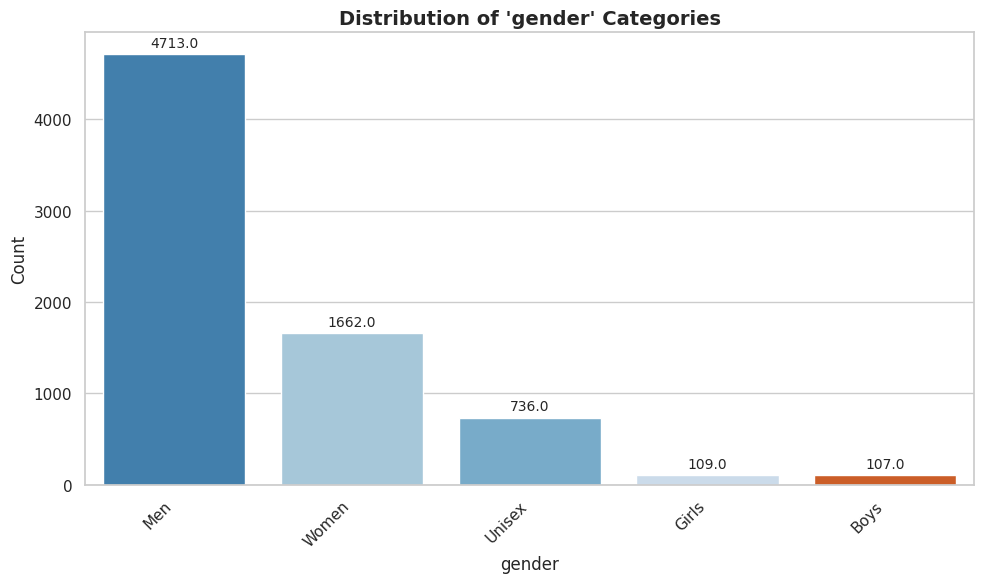

In [9]:
plot_categories(catalog_df, "gender", palette="tab20c")

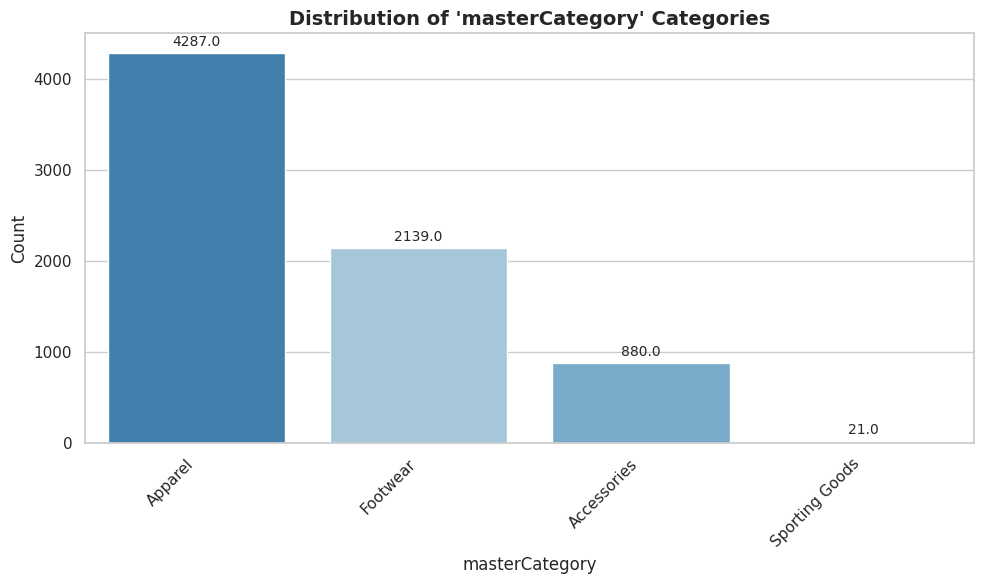

In [10]:
plot_categories(catalog_df, "masterCategory", palette="tab20c")

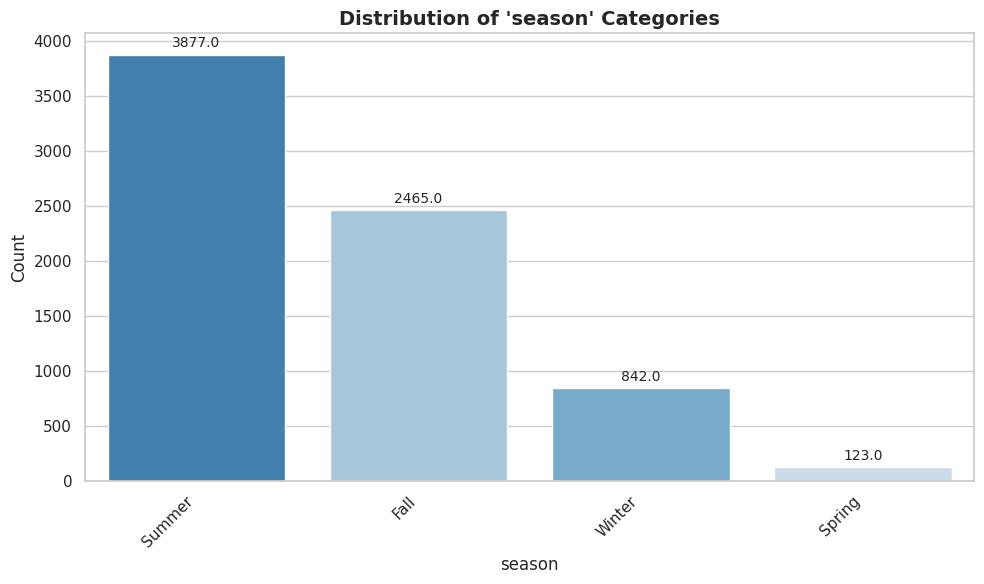

In [11]:
plot_categories(catalog_df, "season", palette="tab20c")

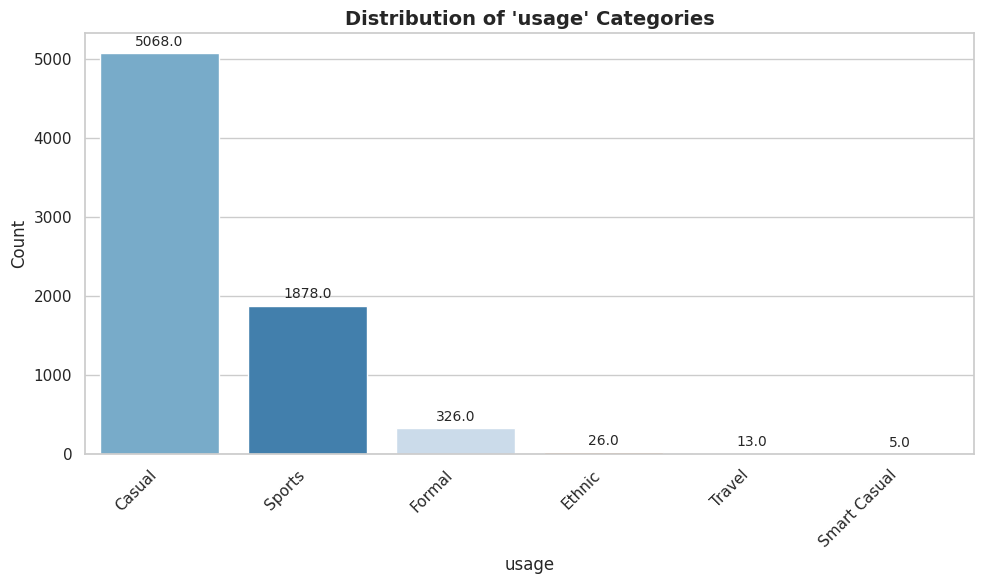

In [12]:
plot_categories(catalog_df, "usage", palette="tab20c")

## 4. UMAP for vectors visualization

**UMAP (Uniform Manifold Approximation and Projection)** is a dimensionality reduction technique used to visualize high-dimensional data like vector embeddings in 2D or 3D space. Here's a quick breakdown:

Purpose: 
- Helps visualize complex data (e.g., image or text embeddings) by projecting them into a lower-dimensional space while preserving their structure.

How it works:
- Models the data as a graph in high dimensions.
- Optimizes a low-dimensional graph to be structurally similar.
  
Why it's useful:
- Reveals clusters, patterns, and relationships in data.
- Often used in NLP, computer vision, and recommendation systems.

### 4.1 2D UMAP

In [13]:
print("Running Umap on the images vectors embeddings...")

start = time.time()

imagevector_array = np.array(catalog_df["imagevector"].to_list())
umap_2d = UMAP(n_components=2, init="random", random_state=None, n_jobs=-1)
proj_2d = umap_2d.fit_transform(imagevector_array)

minutes, seconds = divmod((time.time() - start), 60)
print(f"✅ Done. Elapsed time = {minutes:.0f} minutes and {seconds:.0f} seconds")

Running Umap on the images vectors embeddings...
✅ Done. Elapsed time = 0 minutes and 33 seconds


#### By Category

In [14]:
outputfile1 = plot_2D_umap(IMAGES_DIR, proj_2d, catalog_df, "masterCategory")

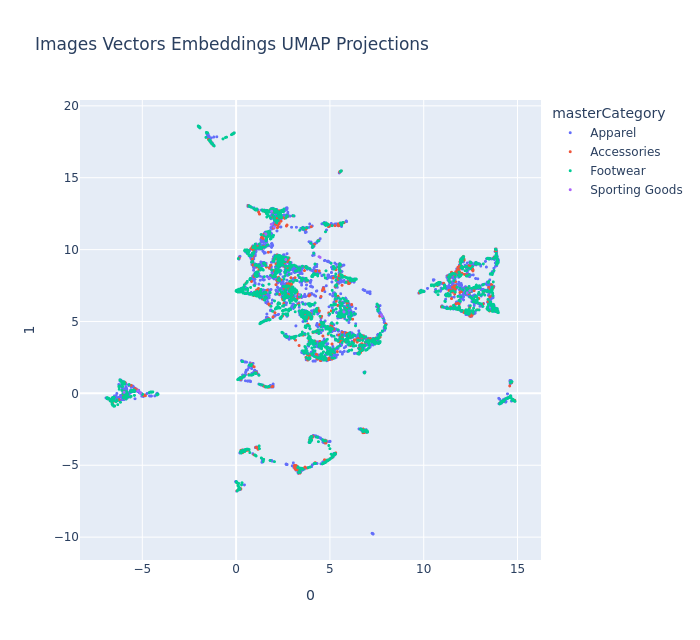

In [15]:
img = Image.open(os.path.join(IMAGES_DIR, outputfile1))
img

#### By season

In [16]:
outputfile2 = plot_2D_umap(IMAGES_DIR, proj_2d, catalog_df, "season")

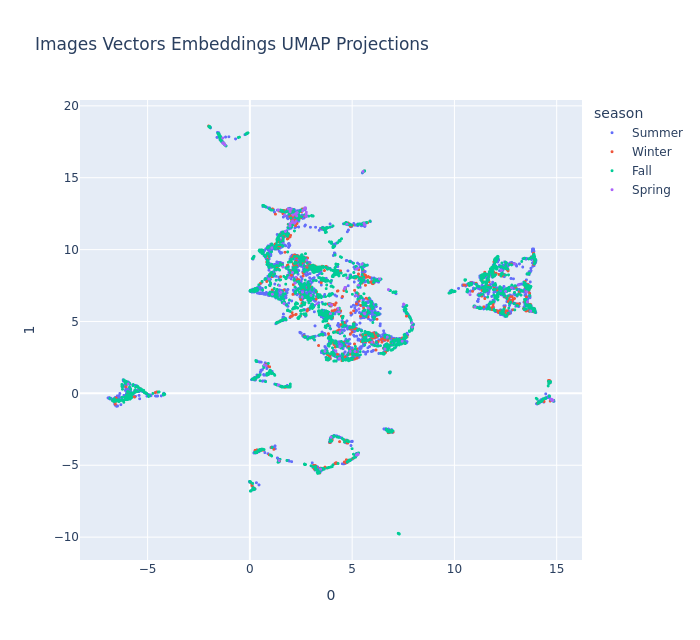

In [17]:
img = Image.open(os.path.join(IMAGES_DIR, outputfile2))
img

### 4.2 3D UMAP

In [18]:
print("Running Umap on the images vectors embeddings...")

start = time.time()

umap_3d = UMAP(n_components=3, init="random", random_state=None, n_jobs=-1)
proj_3d = umap_3d.fit_transform(imagevector_array)

minutes, seconds = divmod((time.time() - start), 60)
print(f"✅ Done. Elapsed time = {minutes:.0f} minutes and {seconds:.0f} seconds")

Running Umap on the images vectors embeddings...
✅ Done. Elapsed time = 0 minutes and 3 seconds


#### By category

In [19]:
outputfile3 = plot_3D_umap(IMAGES_DIR, proj_3d, catalog_df, "masterCategory")

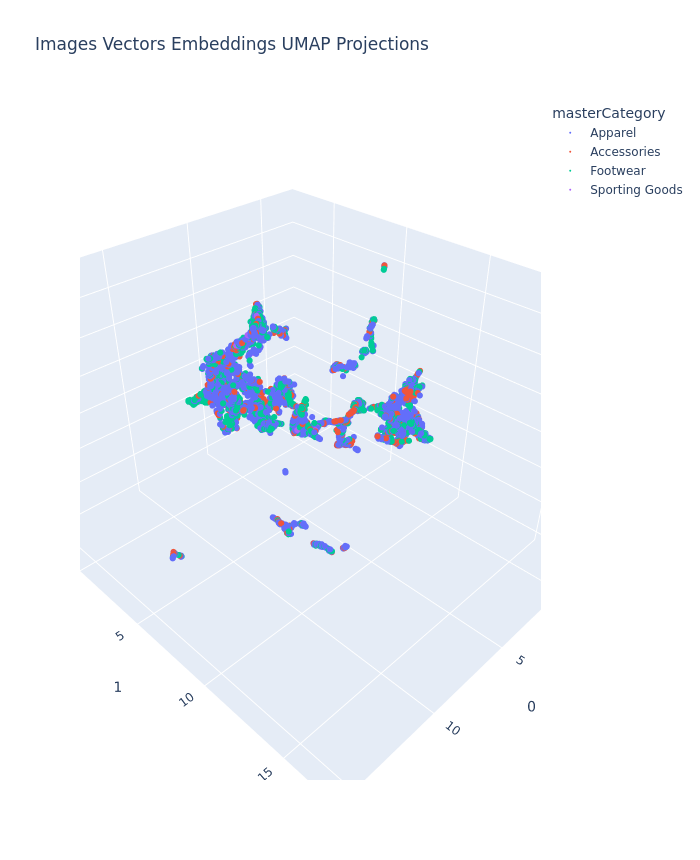

In [20]:
img = Image.open(os.path.join(IMAGES_DIR, outputfile3))
img

In [21]:
proj_3d

array([[ 0.53679585,  7.9885416 ,  1.8944747 ],
       [ 0.55074775,  7.9798527 ,  1.8696831 ],
       [ 0.62011236,  8.039214  ,  1.8294444 ],
       ...,
       [ 4.879032  ,  9.099953  , 10.086719  ],
       [ 5.939545  ,  2.9365995 ,  9.325128  ],
       [ 4.4693165 ,  0.8388001 ,  1.8854584 ]], dtype=float32)